In [12]:
import torch
from torch_geometric.data import Data
from torch_geometric import utils
import networkx as nx
edge_index = torch.tensor([[0, 1],
                           [1, 0],
                           [1, 2],
                           [2, 1]], dtype=torch.long)
x = torch.tensor([[-1], [0], [1]], dtype=torch.float)

data = Data(x=x, edge_index=edge_index.t().contiguous())
                                                    

In [7]:
print(data.keys)

['x', 'edge_index']


In [8]:
print(data['x'])

tensor([[-1.],
        [ 0.],
        [ 1.]])


In [10]:
for key, item in data:
    print("{} found in data".format(key))

edge_index found in data
x found in data


In [12]:
data.num_nodes

3

In [14]:
data.num_edges

4

In [19]:
def summary_torch_geometric_data(data):
    # Print data keys
    print("- Keys of the data : {}".format(data.keys))
    # Print feature of node
    print("- Feature of nodes : {}".format(data['x']))
    print("- Labels (y) : {}".format(data['y']))
    print("- Edge indices : {}".format(data['edge_index']))
    # For loop like dict.items()
    for key, item in data:
        print("- {} found in data".format(key))
    # Checking whether contains given keys
    # Print number of the graph nodes
    print("- Number of nodes : {}".format(data.num_nodes))
    print("- Number of edges : {}".format(data.num_edges))
    # Print number of the node features
    print("- Number of node features : {}".format(data.num_node_features))
    # Check isolated nodes in the graph given
    print("- Does the graph contains isolated nodes? : {}".format(data.contains_isolated_nodes()))
    # Check self loop node exists
    print("- Does the graph contains self-loop nodes? : {}".format(data.contains_self_loops()))
    # Check whether the graph is directed graph of not
    print("- Is the graph directed ? : {}".format(data.is_directed()))

In [2]:
from torch_geometric.datasets import TUDataset, ModelNet, ShapeNet
ds = TUDataset(root='./data/', name='PROTEINS')
ds

PROTEINS(1113)

In [25]:
ds = TUDataset(root='./data/', name='PROTEINS')
dsz

- Keys of the data : ['x', 'edge_index', 'y']
- Feature of nodes : tensor([[1., 0., 0.],
        [1., 0., 0.],
        [1., 0., 0.],
        [1., 0., 0.],
        [1., 0., 0.],
        [1., 0., 0.],
        [1., 0., 0.],
        [1., 0., 0.],
        [1., 0., 0.],
        [1., 0., 0.],
        [1., 0., 0.],
        [1., 0., 0.],
        [1., 0., 0.],
        [1., 0., 0.],
        [1., 0., 0.],
        [1., 0., 0.],
        [1., 0., 0.],
        [1., 0., 0.],
        [1., 0., 0.],
        [1., 0., 0.],
        [1., 0., 0.],
        [1., 0., 0.],
        [1., 0., 0.],
        [1., 0., 0.],
        [0., 1., 0.],
        [0., 1., 0.],
        [0., 1., 0.],
        [0., 1., 0.],
        [0., 1., 0.],
        [0., 1., 0.],
        [0., 1., 0.],
        [0., 1., 0.],
        [0., 1., 0.],
        [0., 1., 0.],
        [0., 1., 0.],
        [0., 1., 0.],
        [0., 1., 0.]])
- Labels (y) : tensor([5])
- Edge indices : tensor([[ 0,  0,  0,  1,  1,  1,  1,  1,  2,  2,  2,  2,  2,  3,  3,  3,  

In [3]:
ds.num_classes

2

In [28]:
dataset.num_node_features


3

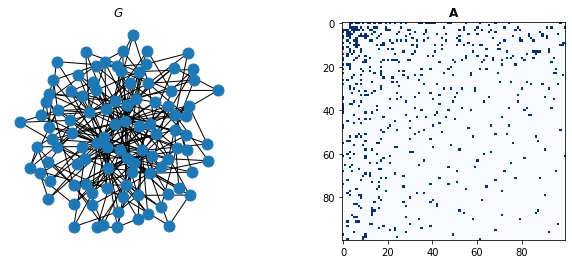

In [34]:
import networkx as nx
import matplotlib.pyplot as plt
G = nx.barabasi_albert_graph(100, 3)
_, axes = plt.subplots(1, 2, figsize=(10, 4), gridspec_kw={'wspace': 0.5})
nx.draw_kamada_kawai(G, ax=axes[0], node_size=120)
axes[1].imshow(nx.to_numpy_matrix(G), aspect='auto', cmap='Blues')
axes[0].set_title("$G$")
axes[1].set_title("$\mathbf{A}$")
plt.show()

In [37]:
!wget -nc https://raw.githubusercontent.com/mikedh/trimesh/master/models/bunny.ply

File ‘bunny.ply’ already there; not retrieving.



In [1]:
import trimesh
m = trimesh.load('bunny.ply')
m.show()

In [2]:
from torch_geometric import utils
data = utils.from_trimesh(m)
data

Data(face=[3, 16301], pos=[8146, 3])

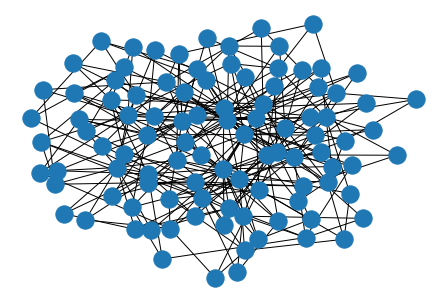

In [4]:
import networkx as nx
G = nx.barabasi_albert_graph(n=100, m=3)
nx.draw_kamada_kawai(G)

In [16]:
from torch_geometric.datasets import TUDataset, ModelNet, ShapeNet
dataset = TUDataset(root='./data/', name='PROTEINS')
dataset

PROTEINS(1113)

In [14]:
import torch
import torch.nn.functional as F
from torch_geometric.nn import GCNConv

class Net(torch.nn.Module):
    def __init__(self):
        super(Net, self).__init__()
        self.conv1 = GCNConv(dataset.num_node_features, 16)
        self.conv2 = GCNConv(16, dataset.num_classes)

    def forward(self, data):
        x, edge_index = data.x, data.edge_index

        x = self.conv1(x, edge_index)
        x = F.relu(x)
        x = F.dropout(x, training=self.training)
        x = self.conv2(x, edge_index)

        return F.log_softmax(x, dim=1)

In [20]:
dataset[0]afrom torch_geometric.datasets import Planetoid

dataset = Planetoid(root='/tmp/Cora', name='Cora')

Data(edge_index=[2, 162], x=[42, 3], y=[1])

In [4]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = Net().to(device)
data = dataset[0].to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=0.01, weight_decay=5e-4)

model.train()
for epoch in range(200):
    optimizer.zero_grad()
    out = model(data)
    loss = F.nll_loss(out[data.train_mask], data.y[data.train_mask])
    loss.backward()
    optimizer.step()

NameError: name 'torch' is not defined

In [ ]:
model.eval()
_, pred = model(data).max(dim=1)
correct = int(pred[data.test_mask].eq(data.y[data.test_mask]).sum().item())
acc = correct / int(data.test_mask.sum())
print('Accuracy: {:.4f}'.format(acc))

In [15]:
from torch_geometric.datasets import TUDataset, ModelNet, ShapeNet
ds = TUDataset(root='./data/', name='PROTEINS')
ds

PROTEINS(1113)

In [18]:
ds.num_classes

2

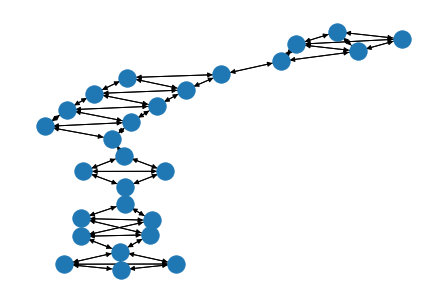

In [19]:
G = utils.to_networkx(ds[1])
nx.draw_kamada_kawai(G)

In [4]:
from torch_geometric.data import InMemoryDataset, download_url
from rdkit import Chem
import pandas as pd

class COVID(InMemoryDataset):
    url = 'https://github.com/yangkevin2/coronavirus_data/raw/master/data/mpro_xchem.csv'
    def __init__(self, root, transform=None, pre_transform=None, pre_filter=None):
        super(COVID, self).__init__(root, transform, pre_transform, pre_filter)
        # Load processed data
        self.data, self.slices = torch.load(self.processed_paths[0])
    @property
    def raw_file_names(self):
        return ['mpro_xchem.csv']
    @property
    def processed_file_names(self):
        return ['data.pt']
    def download(self):
        download_url(self.url, self.raw_dir)
    def process(self):
        df = pd.read_csv(self.raw_paths[0])
        data_list = []
        for smiles, label in df.itertuples(False, None):
            mol = Chem.MolFromSmiles(smiles) # Read the molecule info
            adj = Chem.GetAdjacencyMatrix(mol) # Get molecule structure
            # You should extract other features here!
            data = Data(num_nodes=adj.shape[0],
            edge_index=torch.Tensor(adj).nonzero().T,  y=label)
            data_list.append(data)
        self.data, self.slices = self.collate(data_list)
        torch.save((self.data, self.slices), self.processed_paths[0])

In [27]:
covid = COVID(root='./data/COVID/')
covid

COVID(880)

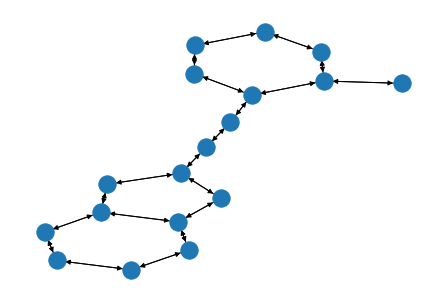

In [29]:
G = utils.to_networkx(covid[0])
nx.draw_kamada_kawai(G)

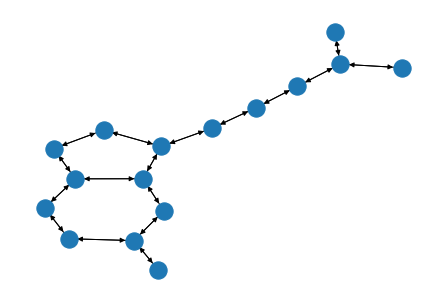

In [31]:
G = utils.to_networkx(covid[1])
nx.draw_kamada_kawai(G)

In [37]:
from torch_geometric.data import Batch
b = Batch.from_data_list(covid[:10])
b

Batch(batch=[166], edge_index=[2, 352], y=[10])

In [17]:
from torch_geometric.nn import GCNConv, JumpingKnowledge, global_add_pool
from torch.nn import functional as F
from torch_geometric import transforms
from skorch import NeuralNetClassifier
import torch
from torch_geometric.data import Batch


class SimpleGNN(torch.nn.Module):
    def __init__(self, dataset, hidden=64, layers=6):
        super(SimpleGNN, self).__init__()
        self.dataset = dataset
        self.convs = torch.nn.ModuleList()
        self.convs.append(GCNConv(in_channels=dataset.num_node_features,
        out_channels=hidden))
        
        for _ in range(1, layers):
            self.convs.append(GCNConv(in_channels=hidden, out_channels=hidden))
            
        self.jk = JumpingKnowledge(mode="cat")
        self.jk_lin = torch.nn.Linear(in_features=hidden*layers, out_features=hidden)
        self.lin_1 = torch.nn.Linear(in_features=hidden, out_features=hidden)
        self.lin_2 = torch.nn.Linear(in_features=hidden, out_features=dataset.num_classes)
    def forward(self, index):
        data = Batch.from_data_list(self.dataset[index])
        x = data.x
        
        #x = x.view(x.size(0), -1)
        xs = []
        for conv in self.convs:
            x = F.relu(conv(x=x, edge_index=data.edge_index))
            xs.append(x)
        #import ipdb; ipdb.set_trace()
        x = self.jk(xs)
        x = F.relu(self.jk_lin(x))
        x = global_add_pool(x, batch=data.batch)
        x = F.relu(self.lin_1(x))
        x = F.softmax(self.lin_2(x), dim=-1)
        return x

In [18]:
ohd = transforms.OneHotDegree(max_degree=4)
covid = COVID(root='./data/COVID/', transform=ohd)
covid[0]

Data(edge_index=[2, 40], x=[18, 5], y=[1])

In [25]:
from sklearn.model_selection import train_test_split
from sklean.metrics import roc_auc_score
X_train, X_test, y_train, y_test = train_test_split(
    torch.arange(len(covid)).long(), covid.data.y, test_size=0.3, random_state=42)

In [59]:
X, y = torch.arange(len(covid)).long(), covid.data.y
net = NeuralNetClassifier(
        module=SimpleGNN,
        module__dataset=covid,
        max_epochs=30,
        batch_size=40,
        lr=0.001
        )
fit = net.fit(X_train, y_train)
from sklearn.metrics import roc_auc_score
print('AUC TRAIN', roc_auc_score(y_train, fit.predict_proba(X_train)[:,0]))
print('AUC TEST', roc_auc_score(y_test, fit.predict_proba(X_test)[:,0]))

  epoch    train_loss    valid_acc    valid_loss     dur
-------  ------------  -----------  ------------  ------
      1        0.6653       0.9113        0.6463  0.3519
      2        0.6250       0.9113        0.6117  0.3511
      3        0.5899       0.9113        0.5810  0.3383
      4        0.5588       0.9113        0.5538  0.3348
      5        0.5312       0.9113        0.5296  0.3346
      6        0.5065       0.9113        0.5077  0.3248
      7        0.4840       0.9113        0.4877  0.3339
      8        0.4634       0.9113        0.4695  0.3375
      9        0.4447       0.9113        0.4532  0.3361
     10        0.4278       0.9113        0.4387  0.3302
     11        0.4128       0.9113        0.4259  0.3332
     12        0.3996       0.9113        0.4149  0.3333
     13        0.3882       0.9113        0.4054  0.3271
     14        0.3783       0.9113        0.3974  0.3564
     15        0.3700       0.9113        0.3907  0.3122
     16        0.3629       0.9

In [67]:
y

tensor([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

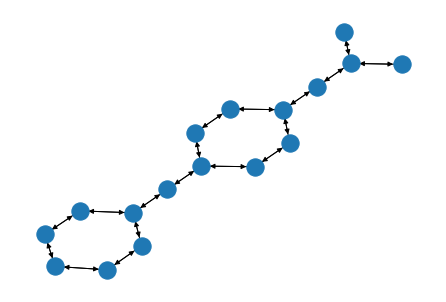

In [68]:
import torch
from torch_geometric.data import Data
from torch_geometric import utils
import networkx as nx

G = utils.to_networkx(covid[4])
nx.draw_kamada_kawai(G)

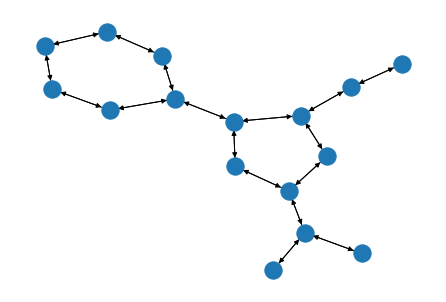

In [79]:
import torch
from torch_geometric.data import Data
from torch_geometric import utils
import networkx as nx
import matplotlib.pyplot as plt

G = utils.to_networkx(covid[250])
nx.draw_kamada_kawai(G)
plt.savefig("Graph.png", format="jpg")
plt.show()

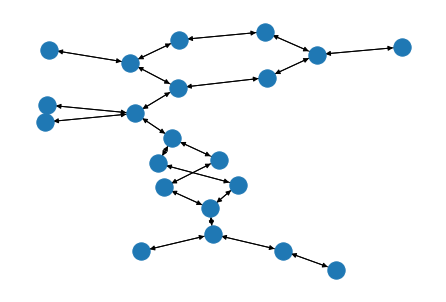

In [106]:
G = utils.to_networkx(covid[int(10)])
nx.draw_kamada_kawai(G)

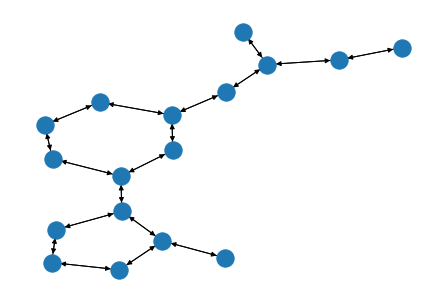

In [107]:
G = utils.to_networkx(covid[23])
nx.draw_kamada_kawai(G)

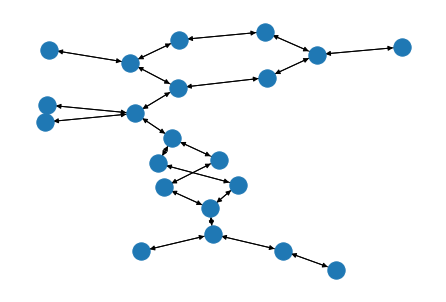

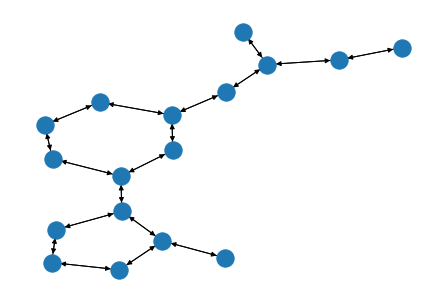

In [115]:
fig = plt.figure()

G = utils.to_networkx(covid[int(10)])
a = nx.draw_kamada_kawai(G)
#plt.show()
del G, a
import gc; gc.collect()
fig = plt.figure(figsize=(6,6))

G = utils.to_networkx(covid[23])
a= nx.draw_kamada_kawai(G)
#plt.show()

/home/dex/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  This is separate from the ipykernel package so we can avoid doing imports until


./train/id_90_y_0.jpg; 0
./train/id_824_y_0.jpg; 0
./train/id_181_y_0.jpg; 0
./train/id_785_y_0.jpg; 0
./train/id_69_y_1.jpg; 1
./train/id_131_y_0.jpg; 0
./train/id_732_y_0.jpg; 0
./train/id_456_y_0.jpg; 0
./train/id_135_y_0.jpg; 0
./train/id_164_y_0.jpg; 0
./train/id_28_y_1.jpg; 1
./train/id_839_y_0.jpg; 0
./train/id_193_y_0.jpg; 0
./train/id_783_y_0.jpg; 0
./train/id_485_y_0.jpg; 0
./train/id_368_y_0.jpg; 0
./train/id_140_y_0.jpg; 0
./train/id_173_y_0.jpg; 0
./train/id_6_y_1.jpg; 1
./train/id_568_y_0.jpg; 0


/home/dex/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


./train/id_360_y_0.jpg; 0
./train/id_73_y_1.jpg; 1
./train/id_605_y_0.jpg; 0
./train/id_820_y_0.jpg; 0
./train/id_655_y_0.jpg; 0
./train/id_145_y_0.jpg; 0
./train/id_234_y_0.jpg; 0
./train/id_220_y_0.jpg; 0
./train/id_357_y_0.jpg; 0
./train/id_375_y_0.jpg; 0
./train/id_132_y_0.jpg; 0
./train/id_439_y_0.jpg; 0
./train/id_311_y_0.jpg; 0
./train/id_495_y_0.jpg; 0
./train/id_41_y_1.jpg; 1
./train/id_538_y_0.jpg; 0
./train/id_108_y_0.jpg; 0
./train/id_405_y_0.jpg; 0
./train/id_56_y_1.jpg; 1
./train/id_309_y_0.jpg; 0
./train/id_334_y_0.jpg; 0
./train/id_478_y_0.jpg; 0
./train/id_24_y_1.jpg; 1
./train/id_338_y_0.jpg; 0
./train/id_855_y_0.jpg; 0
./train/id_757_y_0.jpg; 0
./train/id_51_y_1.jpg; 1
./train/id_578_y_0.jpg; 0
./train/id_806_y_0.jpg; 0
./train/id_844_y_0.jpg; 0
./train/id_264_y_0.jpg; 0
./train/id_420_y_0.jpg; 0
./train/id_604_y_0.jpg; 0
./train/id_394_y_0.jpg; 0
./train/id_755_y_0.jpg; 0
./train/id_18_y_1.jpg; 1
./train/id_688_y_0.jpg; 0
./train/id_326_y_0.jpg; 0
./train/id_83_y_0.

./train/id_742_y_0.jpg; 0
./train/id_672_y_0.jpg; 0
./train/id_8_y_1.jpg; 1
./train/id_712_y_0.jpg; 0
./train/id_36_y_1.jpg; 1
./train/id_452_y_0.jpg; 0
./train/id_253_y_0.jpg; 0
./train/id_303_y_0.jpg; 0
./train/id_658_y_0.jpg; 0
./train/id_571_y_0.jpg; 0
./train/id_687_y_0.jpg; 0
./train/id_636_y_0.jpg; 0
./train/id_262_y_0.jpg; 0
./train/id_610_y_0.jpg; 0
./train/id_297_y_0.jpg; 0
./train/id_414_y_0.jpg; 0
./train/id_150_y_0.jpg; 0
./train/id_695_y_0.jpg; 0
./train/id_779_y_0.jpg; 0
./train/id_550_y_0.jpg; 0
./train/id_488_y_0.jpg; 0
./train/id_147_y_0.jpg; 0
./train/id_146_y_0.jpg; 0
./train/id_651_y_0.jpg; 0
./train/id_816_y_0.jpg; 0
./train/id_652_y_0.jpg; 0
./train/id_348_y_0.jpg; 0
./train/id_463_y_0.jpg; 0
./train/id_325_y_0.jpg; 0
./train/id_186_y_0.jpg; 0
./train/id_123_y_0.jpg; 0
./train/id_749_y_0.jpg; 0
./train/id_608_y_0.jpg; 0
./train/id_143_y_0.jpg; 0
./train/id_841_y_0.jpg; 0
./train/id_197_y_0.jpg; 0
./train/id_609_y_0.jpg; 0
./train/id_279_y_0.jpg; 0
./train/id_293_

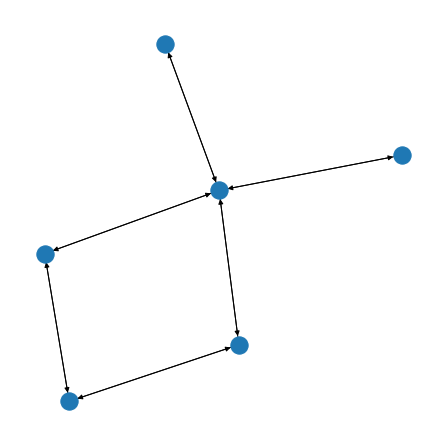

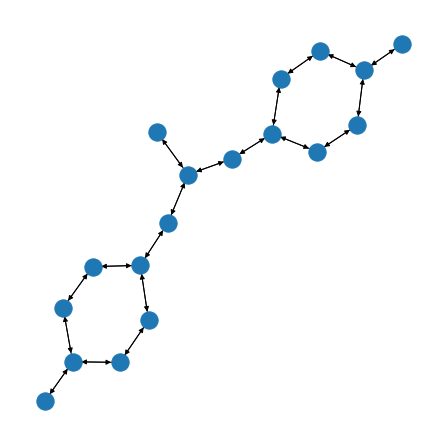

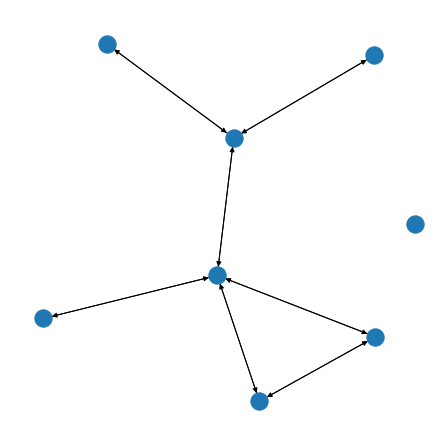

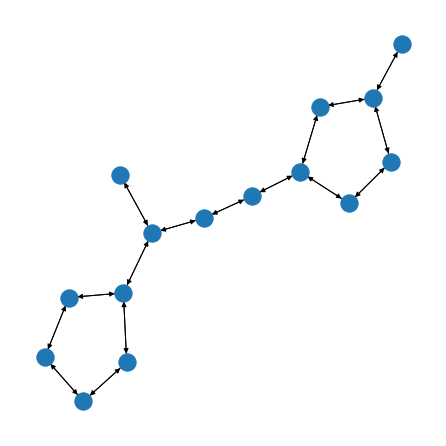

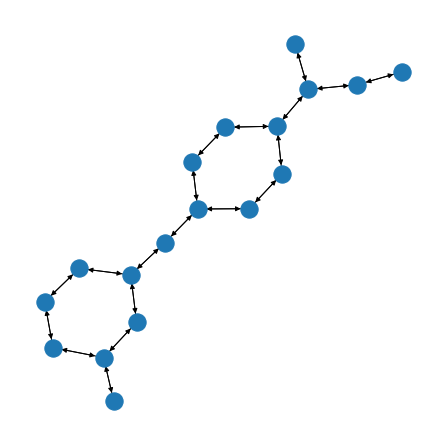

...

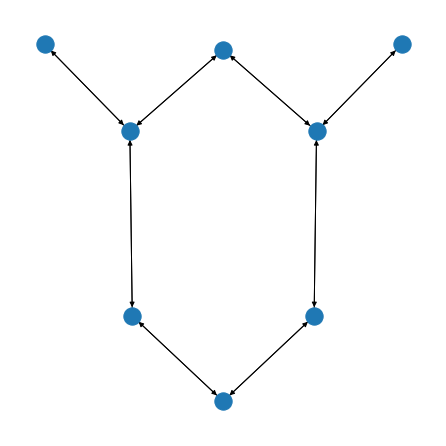

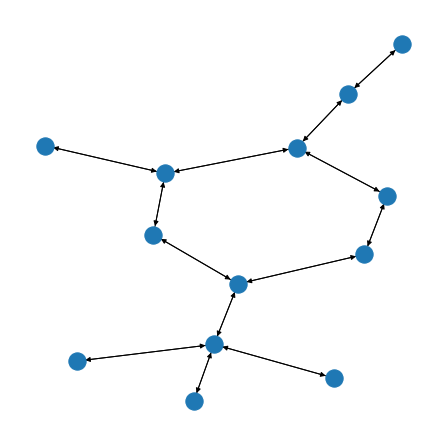

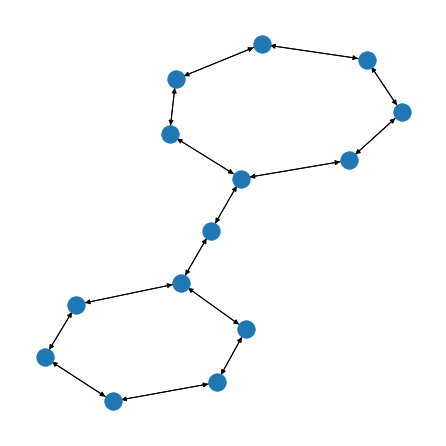

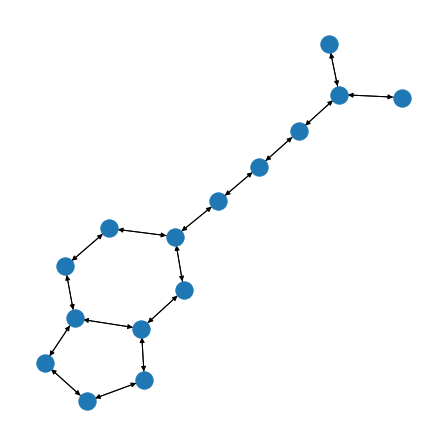

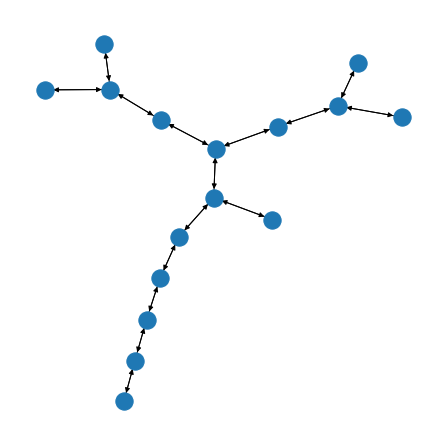

In [119]:
# train
from tqdm import tqdm_notebook as tqdm
for graph in tqdm(X_train):
    fig = plt.figure(figsize=(6,6))
    G = utils.to_networkx(covid[int(graph)])
    a = nx.draw_kamada_kawai(G)
    plt.savefig("./train/id_{}_y_{}.jpg".format(int(graph), y[int(graph)]), format="jpg")
    print("./train/id_{}_y_{}.jpg".format(int(graph), y[int(graph)]), int(y[int(graph)]), sep = "; ")  

/home/dex/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  


./test/id_331_y_0.jpg; 0
./test/id_247_y_0.jpg; 0
./test/id_790_y_0.jpg; 0
./test/id_316_y_0.jpg; 0
./test/id_215_y_0.jpg; 0
./test/id_680_y_0.jpg; 0
./test/id_585_y_0.jpg; 0
./test/id_462_y_0.jpg; 0
./test/id_815_y_0.jpg; 0
./test/id_39_y_1.jpg; 1
./test/id_430_y_0.jpg; 0
./test/id_696_y_0.jpg; 0
./test/id_875_y_0.jpg; 0
./test/id_328_y_0.jpg; 0
./test/id_611_y_0.jpg; 0
./test/id_23_y_1.jpg; 1
./test/id_501_y_0.jpg; 0
./test/id_198_y_0.jpg; 0
./test/id_110_y_0.jpg; 0
./test/id_728_y_0.jpg; 0


/home/dex/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


./test/id_673_y_0.jpg; 0
./test/id_426_y_0.jpg; 0
./test/id_786_y_0.jpg; 0
./test/id_66_y_1.jpg; 1
./test/id_44_y_1.jpg; 1
./test/id_684_y_0.jpg; 0
./test/id_808_y_0.jpg; 0
./test/id_76_y_1.jpg; 1
./test/id_678_y_0.jpg; 0
./test/id_67_y_1.jpg; 1
./test/id_30_y_1.jpg; 1
./test/id_792_y_0.jpg; 0
./test/id_86_y_0.jpg; 0
./test/id_432_y_0.jpg; 0
./test/id_623_y_0.jpg; 0
./test/id_286_y_0.jpg; 0
./test/id_299_y_0.jpg; 0
./test/id_70_y_1.jpg; 1
./test/id_809_y_0.jpg; 0
./test/id_523_y_0.jpg; 0
./test/id_530_y_0.jpg; 0
./test/id_120_y_0.jpg; 0
./test/id_312_y_0.jpg; 0
./test/id_174_y_0.jpg; 0
./test/id_137_y_0.jpg; 0
./test/id_139_y_0.jpg; 0
./test/id_72_y_1.jpg; 1
./test/id_570_y_0.jpg; 0
./test/id_298_y_0.jpg; 0
./test/id_513_y_0.jpg; 0
./test/id_529_y_0.jpg; 0
./test/id_507_y_0.jpg; 0
./test/id_825_y_0.jpg; 0
./test/id_615_y_0.jpg; 0
./test/id_866_y_0.jpg; 0
./test/id_499_y_0.jpg; 0
./test/id_448_y_0.jpg; 0
./test/id_589_y_0.jpg; 0
./test/id_638_y_0.jpg; 0
./test/id_323_y_0.jpg; 0
./test/i

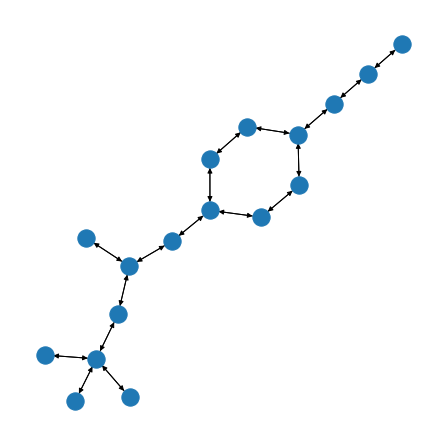

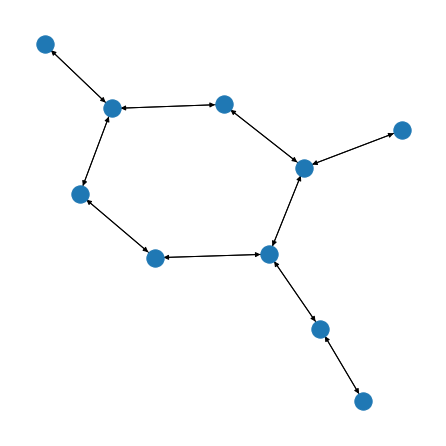

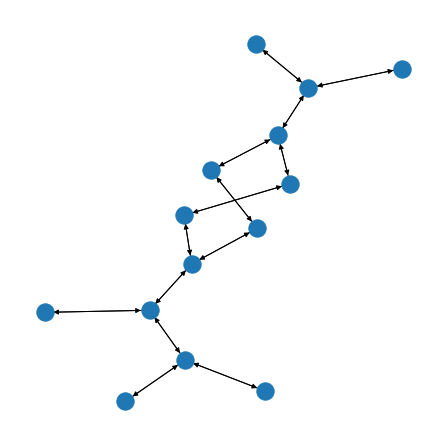

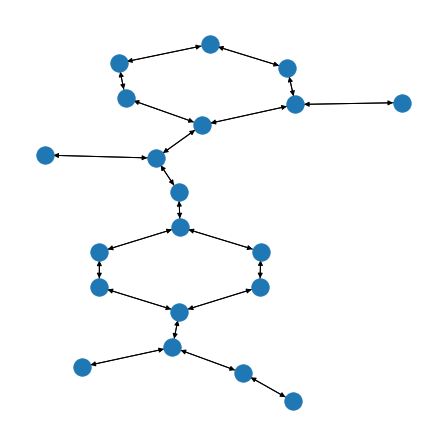

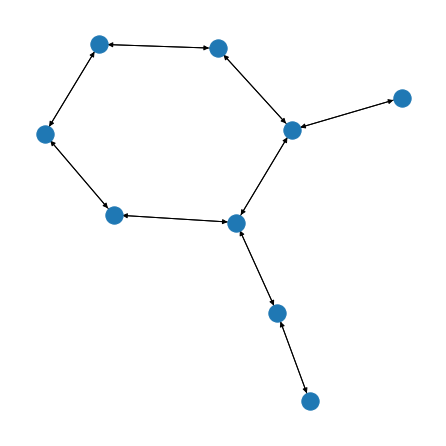

...

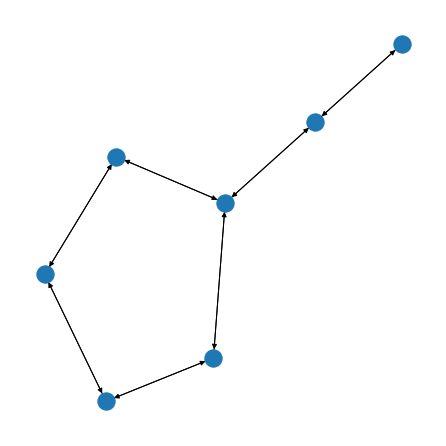

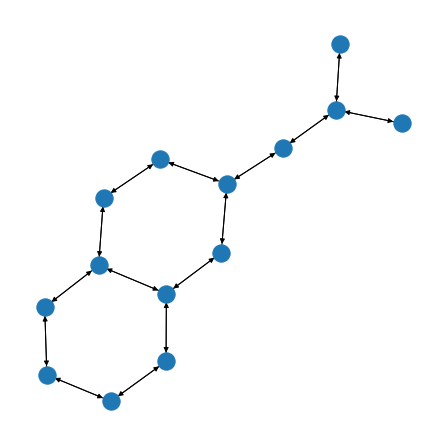

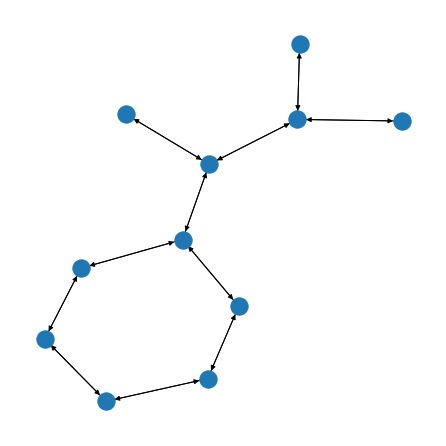

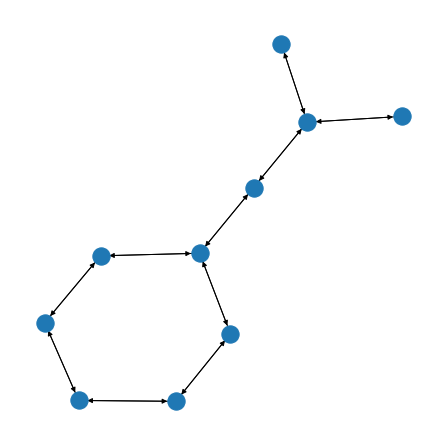

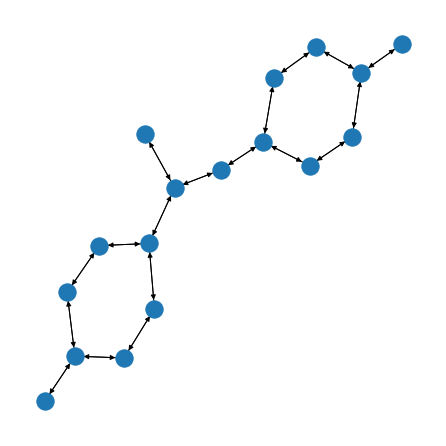

In [120]:
# test
for graph in tqdm(X_test):
    fig = plt.figure(figsize=(6,6))
    G = utils.to_networkx(covid[int(graph)])
    a = nx.draw_kamada_kawai(G)
    plt.savefig("./test/id_{}_y_{}.jpg".format(int(graph), y[int(graph)]), format="jpg")
    print("./test/id_{}_y_{}.jpg".format(int(graph), y[int(graph)]), int(y[int(graph)]), sep = "; ")  